In [1]:
from src.models import base_model
from src.data import data

Using TensorFlow backend.


In [2]:
models_path = data.PATH().MODELS_PATH

In [3]:
!ls '/home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification//models/CNN_Model/2019-11-17__01_25'

instance.pkl  model.h5	model.json


In [4]:
model_path = '/home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification//models/CNN_Model/2019-11-17__01_25/'

In [5]:
model = base_model.BaseModel.load_model(model_path)

W1117 16:49:33.845054 140067973474112 deprecation_wrapper.py:119] From /home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification/src/models/base_model.py:102: The name tf.keras.backend.get_session is deprecated. Please use tf.compat.v1.keras.backend.get_session instead.

W1117 16:49:33.900569 140067973474112 deprecation_wrapper.py:119] From /home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification/src/models/base_model.py:102: The name tf.global_variables_initializer is deprecated. Please use tf.compat.v1.global_variables_initializer instead.



In [6]:
model.model_hist

{'val_loss': [9.934129856655664,
  10.583558386674232,
  10.371436760243022,
  9.613662299082131,
  9.806516723896884,
  9.895340609356499,
  9.157842521817813,
  10.00091383066805,
  8.951491592865828,
  11.496209922873245,
  8.595171675092516,
  9.108906066713855,
  11.501355235319956,
  10.733900318177676,
  8.942216949408854,
  9.917058303954382],
 'val_categorical_accuracy': [0.39096324307188884,
  0.30949440676398,
  0.3261295949192383,
  0.44798779640724,
  0.39078703231089407,
  0.3831541482075025,
  0.44214005551536245,
  0.36408542817046907,
  0.4762216646295966,
  0.3625962519145486,
  0.5005811423563375,
  0.4859799509969506,
  0.38329943364044183,
  0.39260633876849155,
  0.48020485286321746,
  0.4520194686366889],
 'loss': [10.903342241672158,
  10.45413361627698,
  10.302200320332377,
  10.326141168220992,
  9.36236509695105,
  9.53288782724354,
  9.402947902668224,
  10.414334439586426,
  9.565182009143433,
  9.274124951456114,
  9.072900079957002,
  9.447505713921018,


In [6]:
dataset_path = f'{data.PATH().PROCESSED_DATA_PATH}/REI-Dataset'

In [7]:
dataset_path

'/home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification//data//processed//REI-Dataset'

In [8]:
from PIL import Image
import numpy as np

In [9]:
url = 'https://b3h2.scene7.com/is/image/BedBathandBeyond/99629747526259p?$imagePLP$&wid=363&hei=363'

In [10]:
from keras.applications.vgg16 import decode_predictions
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import img_to_array

In [27]:
dataset_path

'/home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification//data//processed//REI-Dataset'

In [ ]:
/home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification//data//processed//REI-Dataset/train/bedroom/bedroom (273).jpeg

In [44]:
image = Image.open('/home/ifranco/Documents/facultad/tesis/tf_real_estate_images_classification//data//processed//REI-Dataset/train/bedroom/bedroom (273).jpeg')

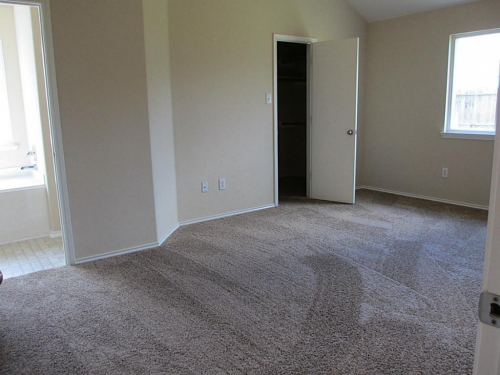

In [45]:
image

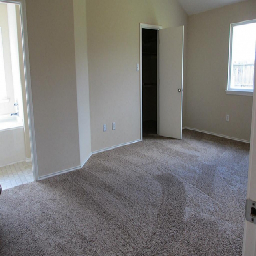

In [46]:
image.resize((256, 256))

In [48]:
image = image.resize((256, 256))
image = img_to_array(image)
arr_image = np.array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
# image = preprocess_input(image)
yhat = model.model.predict(image)

In [49]:
yhat

array([[6.2602074e-10, 2.6799056e-01, 4.8845553e-11, 3.9811166e-08,
        1.4628118e-01, 5.8572829e-01]], dtype=float32)

In [50]:
# label = decode_predictions(yhat)
# label = label[0][0]
#print('{} ({})'.format(label[1], label[2] * 100))

In [51]:
from tensorflow.keras import backend as k

In [52]:
from importlib import reload

conv2d_1/Relu:0 (1, 252, 252, 32) 


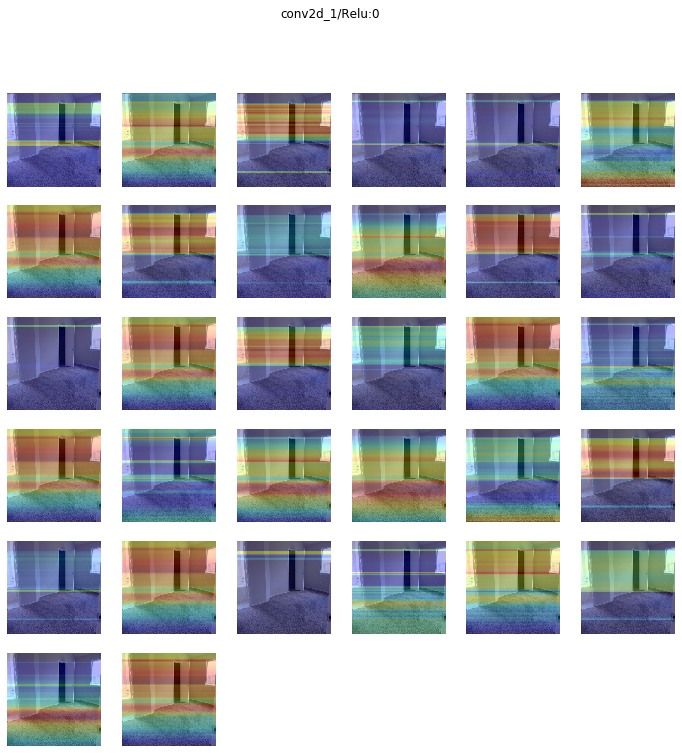

batch_normalization_1/cond/Merge:0 (1, 252, 252, 32) 


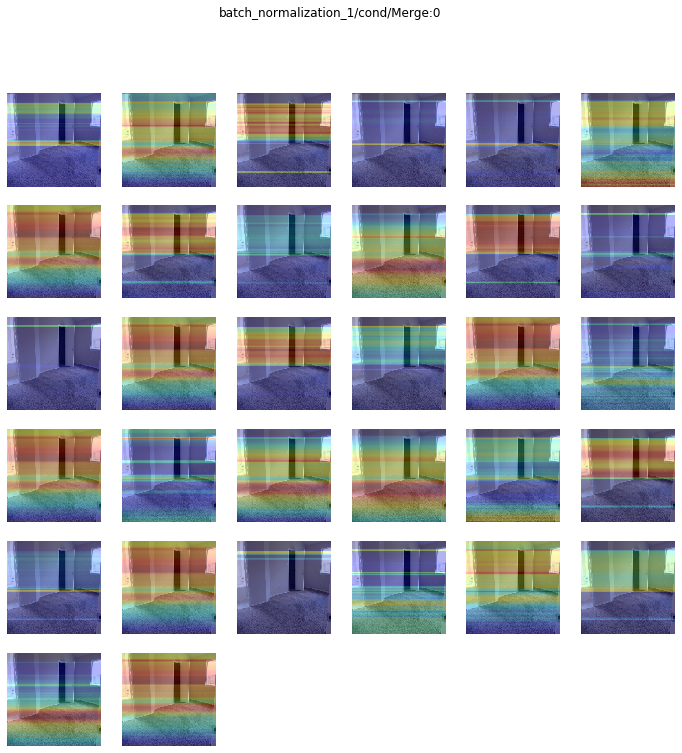

conv2d_2/Relu:0 (1, 248, 248, 32) 


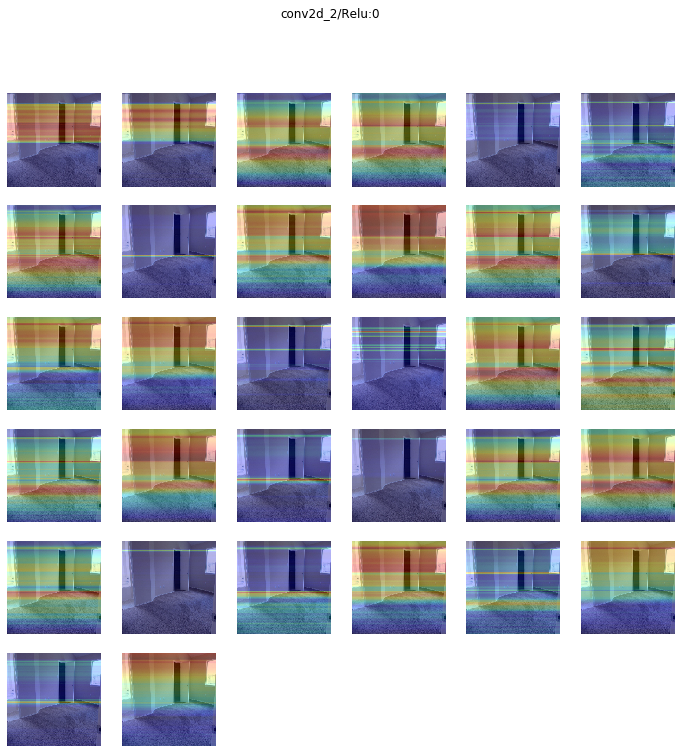

batch_normalization_2/cond/Merge:0 (1, 248, 248, 32) 


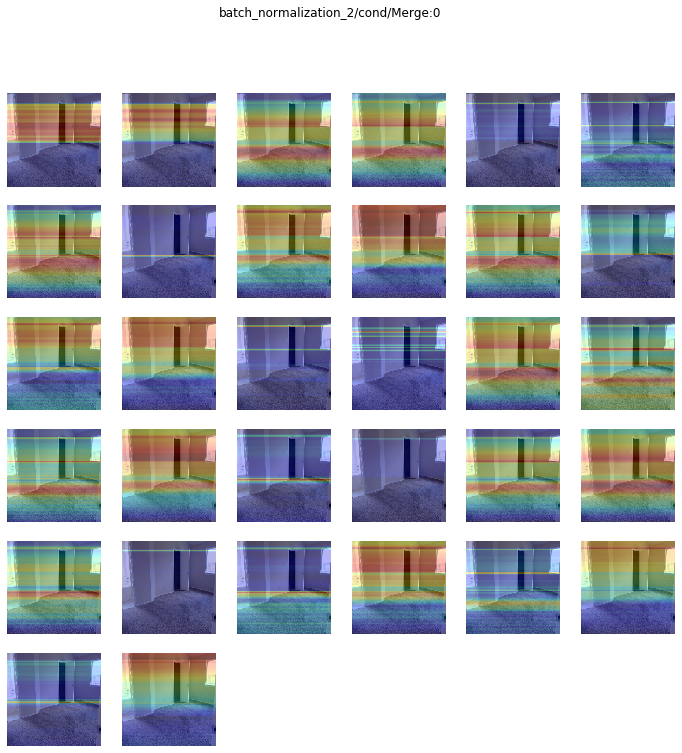

max_pooling2d_1/MaxPool:0 (1, 124, 124, 32) 


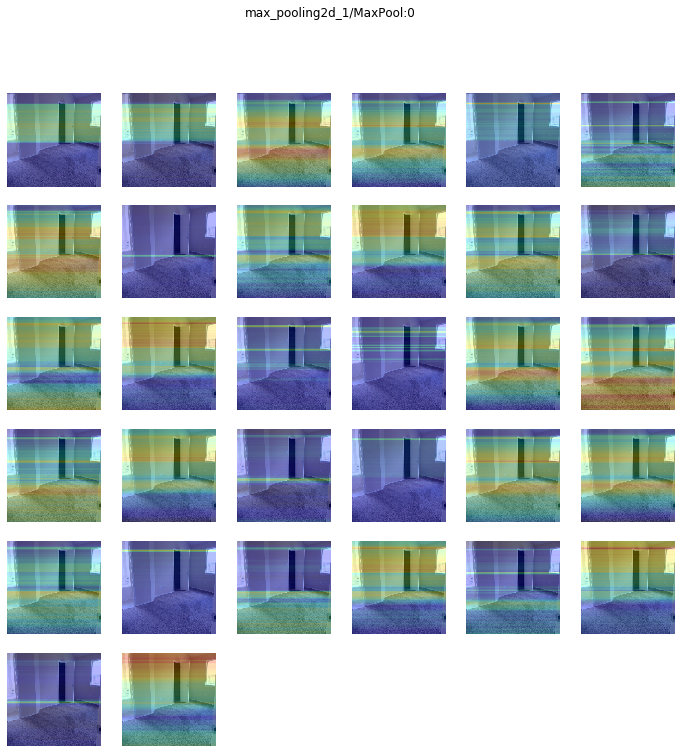

dropout_1/cond/Merge:0 (1, 124, 124, 32) 


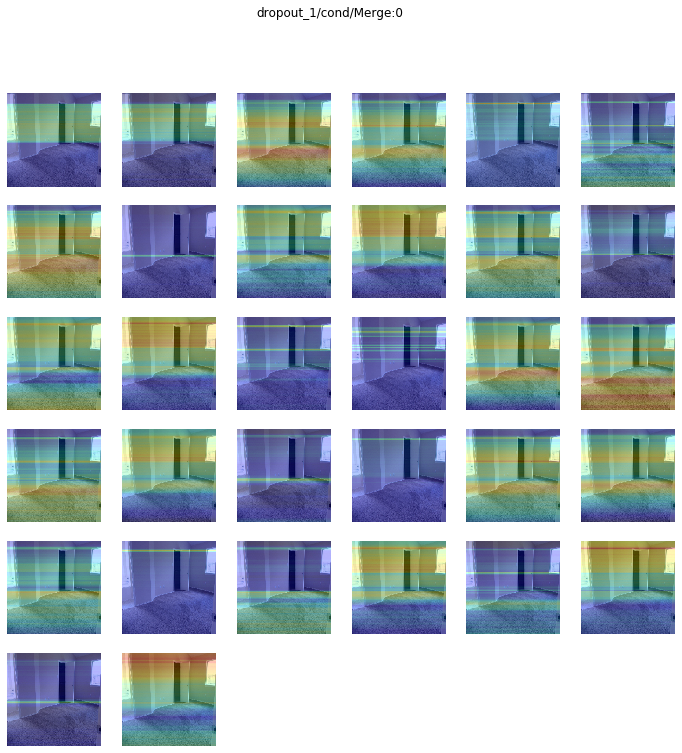

conv2d_3/Relu:0 (1, 120, 120, 64) 


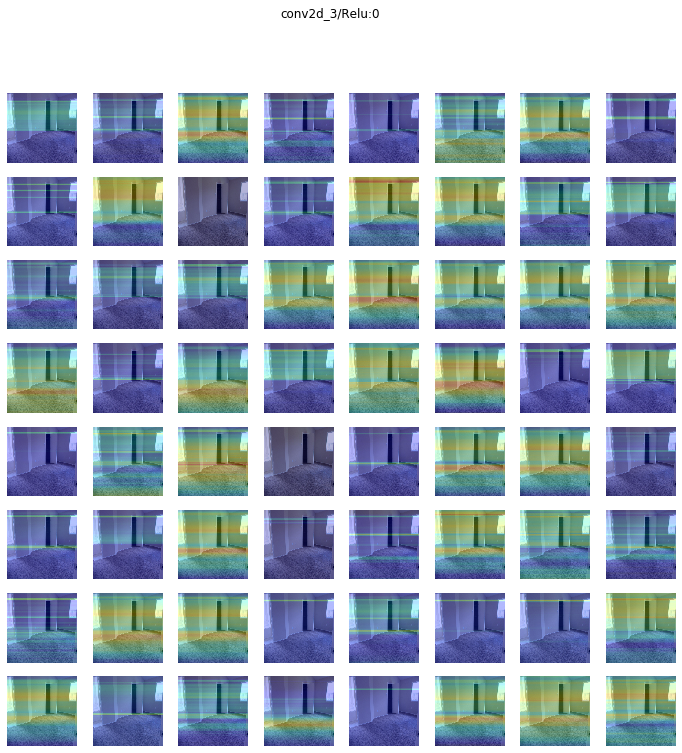

batch_normalization_3/cond/Merge:0 (1, 120, 120, 64) 


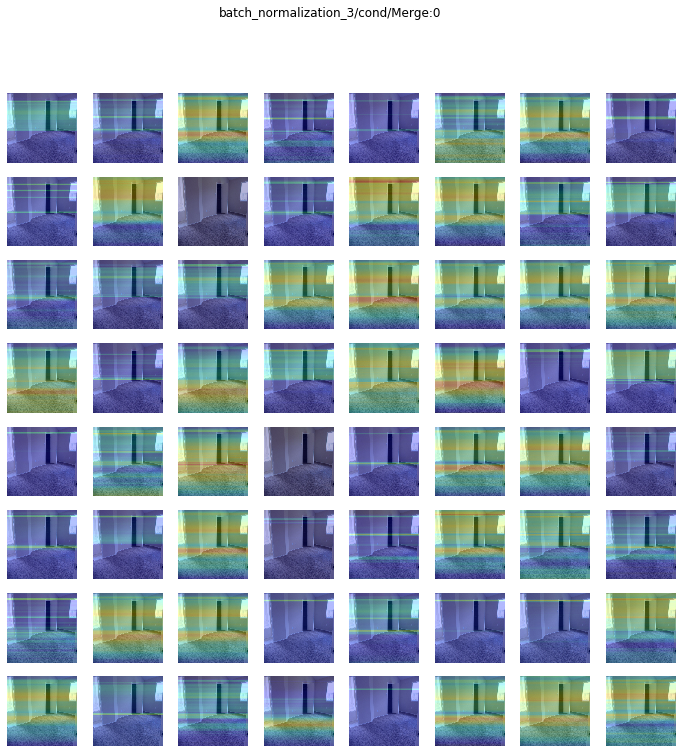

conv2d_4/Relu:0 (1, 116, 116, 64) 


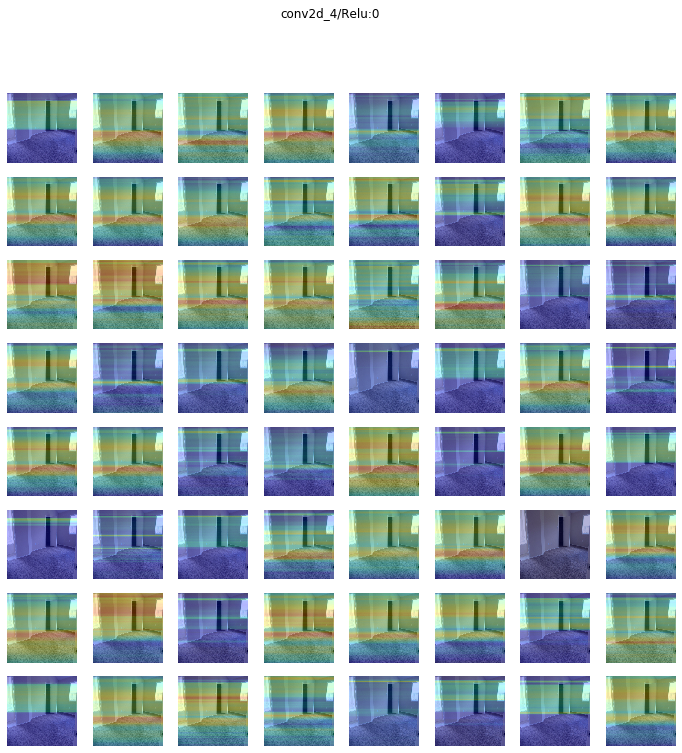

batch_normalization_4/cond/Merge:0 (1, 116, 116, 64) 


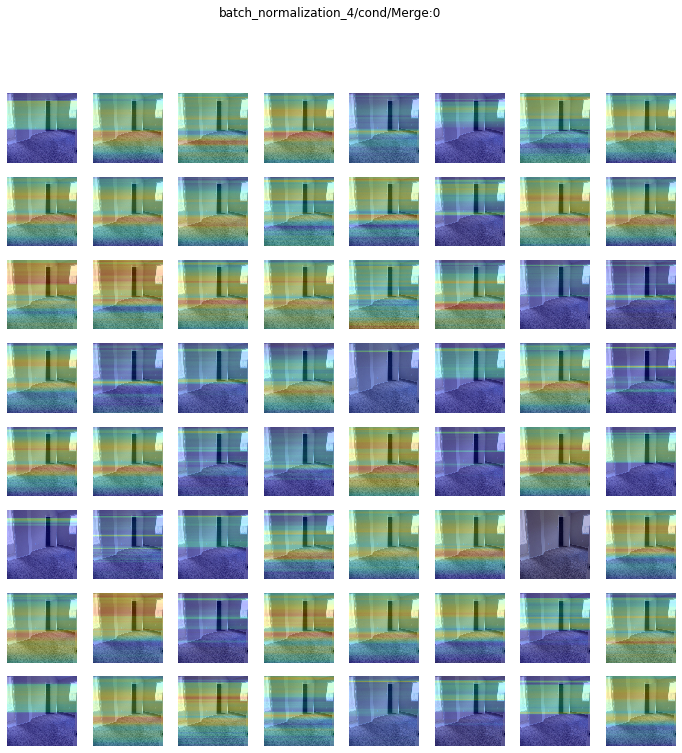

max_pooling2d_2/MaxPool:0 (1, 58, 58, 64) 


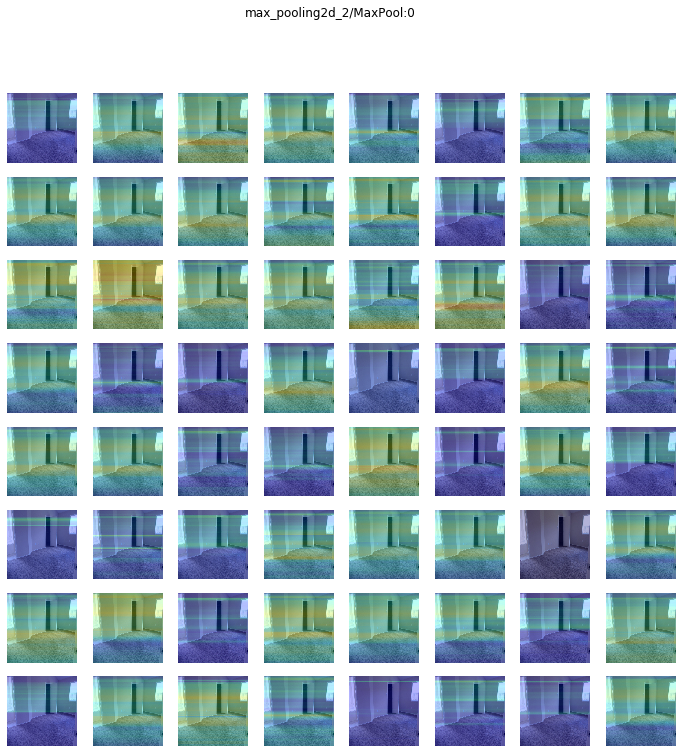

dropout_2/cond/Merge:0 (1, 58, 58, 64) 


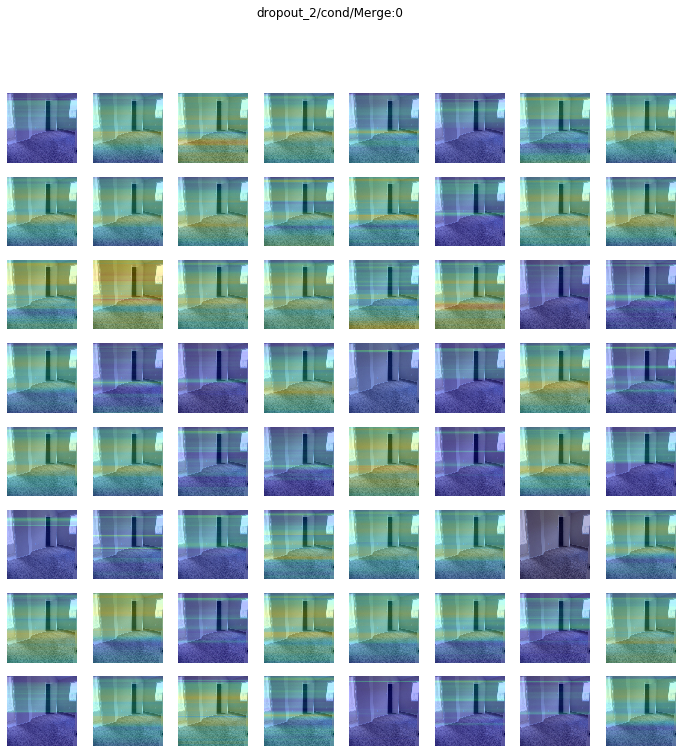

flatten_1/Reshape:0 (1, 215296) -> Skipped. 2D Activations.
dense_1/Relu:0 (1, 256) -> Skipped. 2D Activations.
dropout_3/cond/Merge:0 (1, 256) -> Skipped. 2D Activations.
dense_2/Softmax:0 (1, 6) -> Skipped. 2D Activations.


In [53]:
from keract import get_activations, display_heatmaps

activations = get_activations(model.model, image)
display_heatmaps(activations, arr_image,)

In [43]:
model.model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 252, 252, 32)      2432      
_________________________________________________________________
batch_normalization_1 (Batch (None, 252, 252, 32)      128       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 248, 248, 32)      25632     
_________________________________________________________________
batch_normalization_2 (Batch (None, 248, 248, 32)      128       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 124, 124, 32)      0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 124, 124, 32)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 120, 120, 64)     

In [18]:
from keract import display_activations

In [21]:
activations = get_activations(model.model, image)

conv2d_1/Relu:0 (1, 252, 252, 32) 


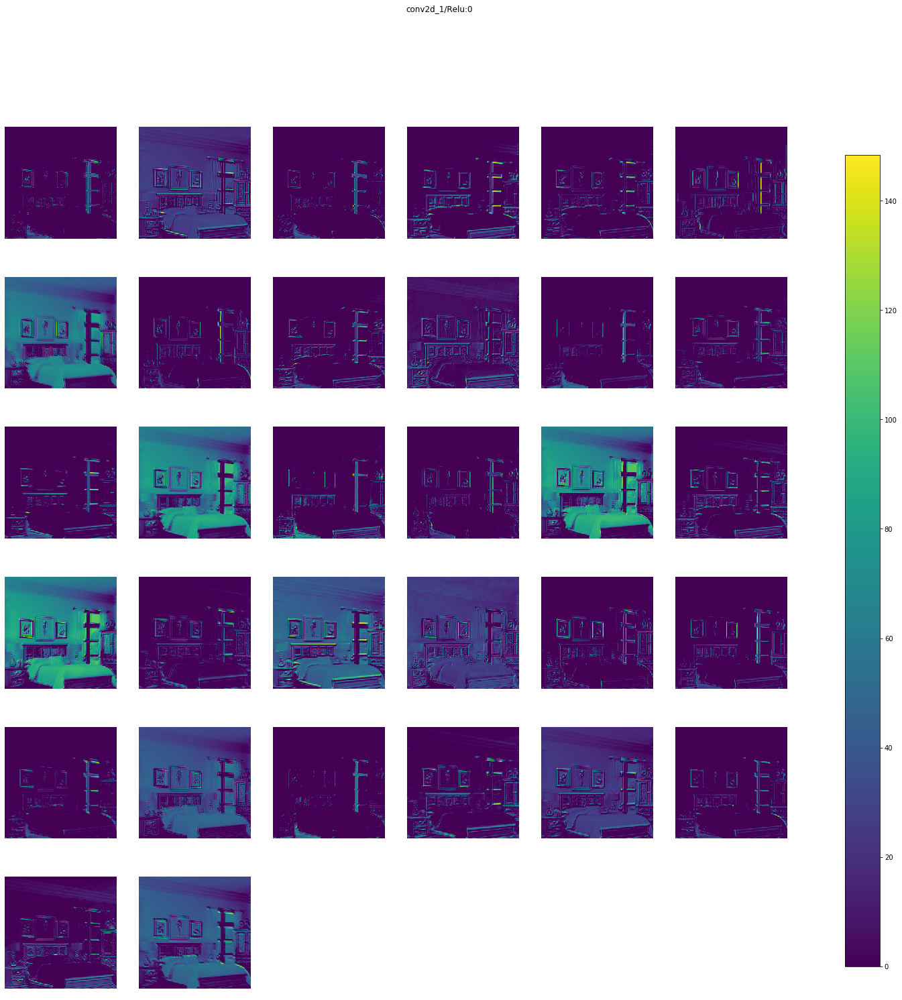

batch_normalization_1/cond/Merge:0 (1, 252, 252, 32) 


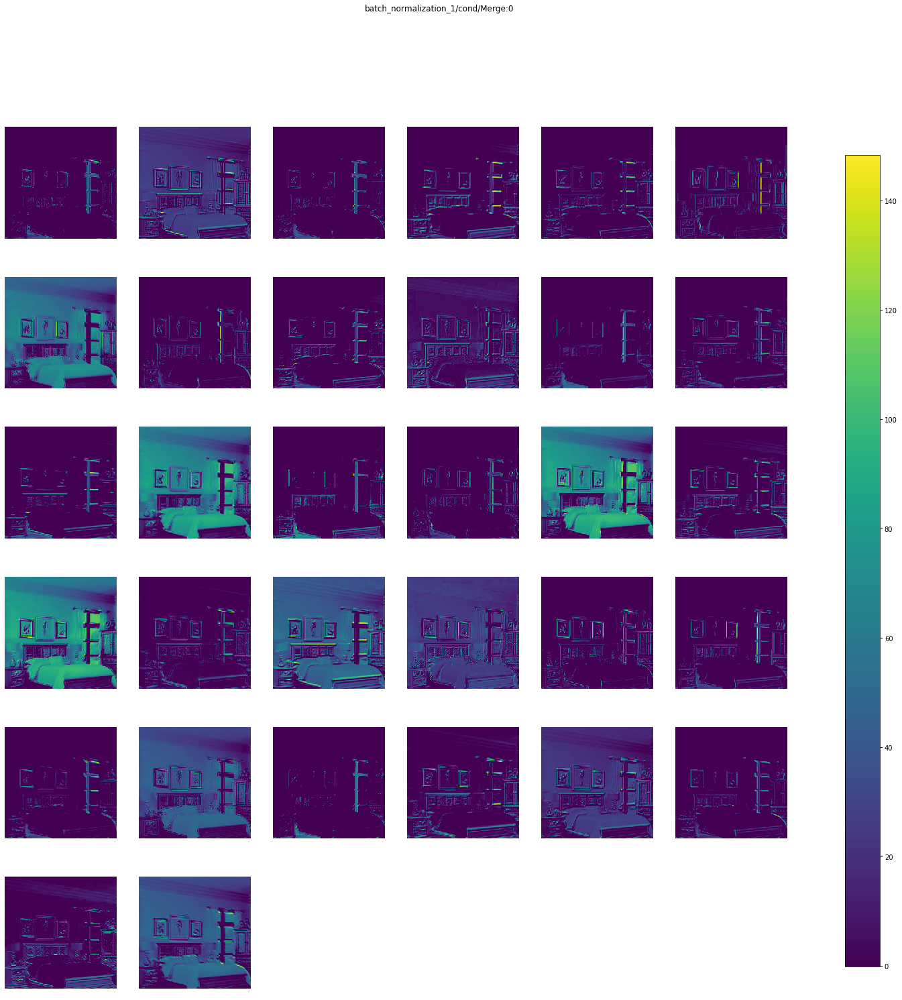

conv2d_2/Relu:0 (1, 248, 248, 32) 


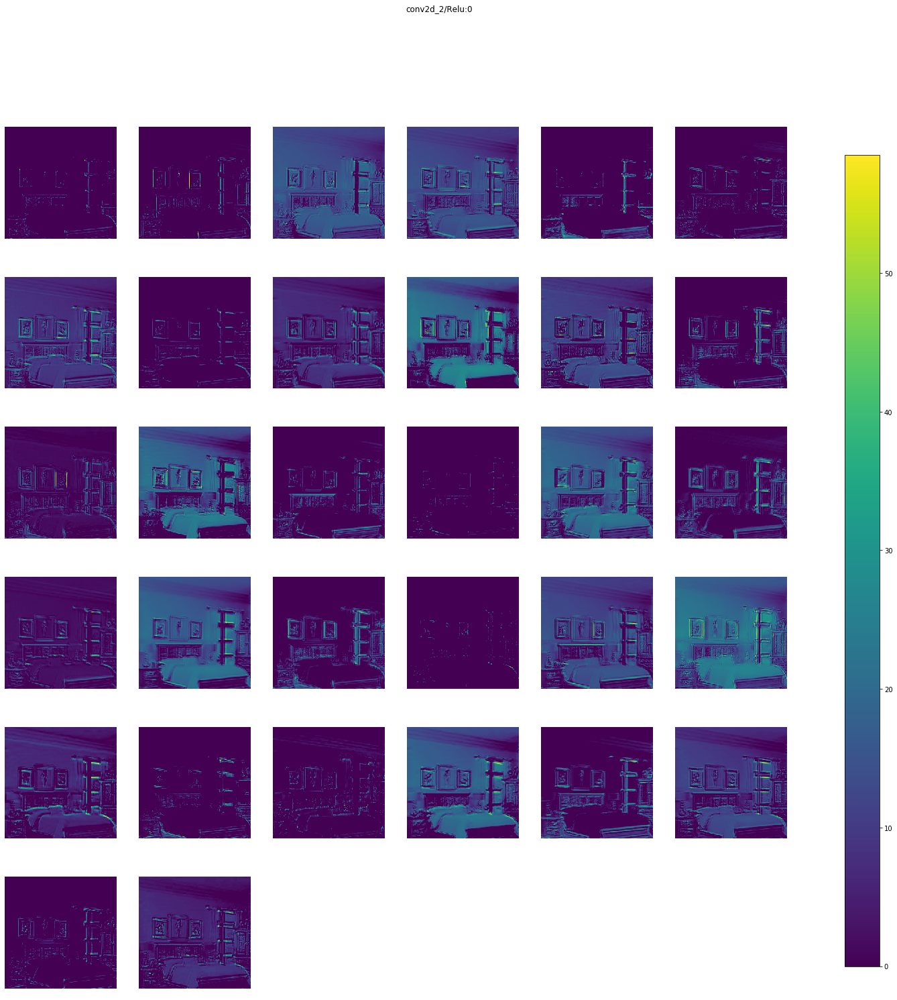

batch_normalization_2/cond/Merge:0 (1, 248, 248, 32) 


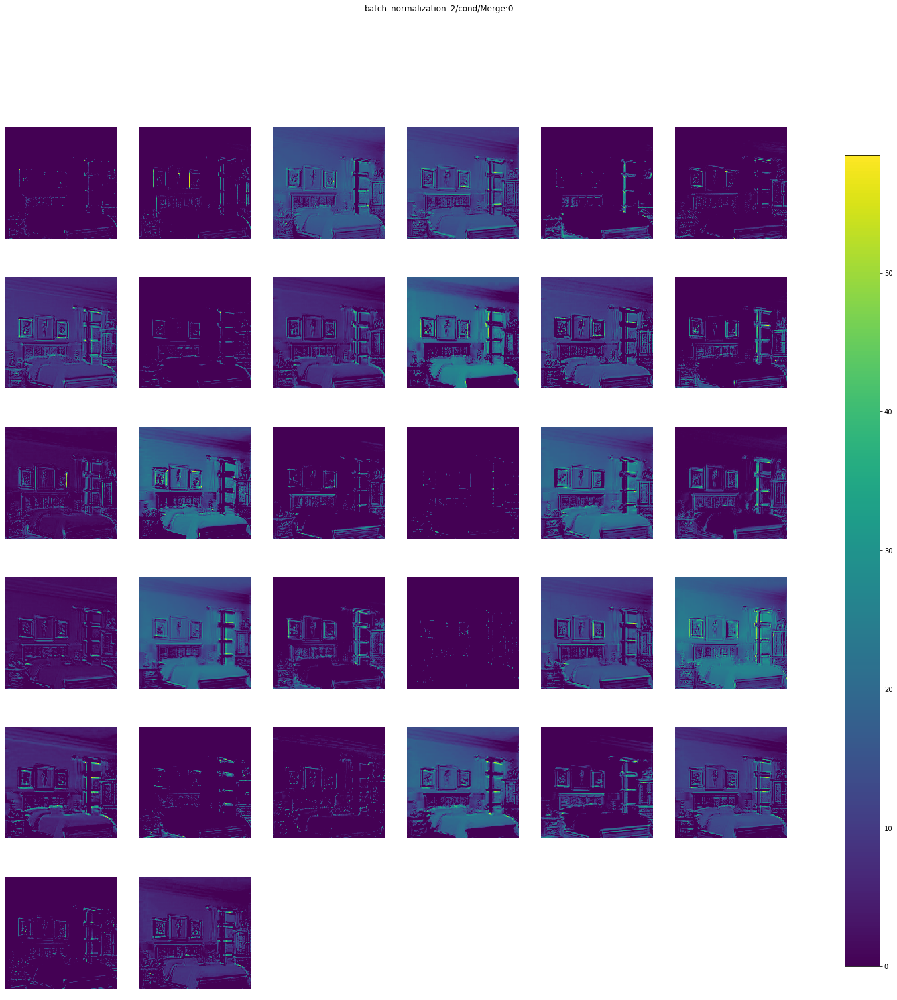

max_pooling2d_1/MaxPool:0 (1, 124, 124, 32) 


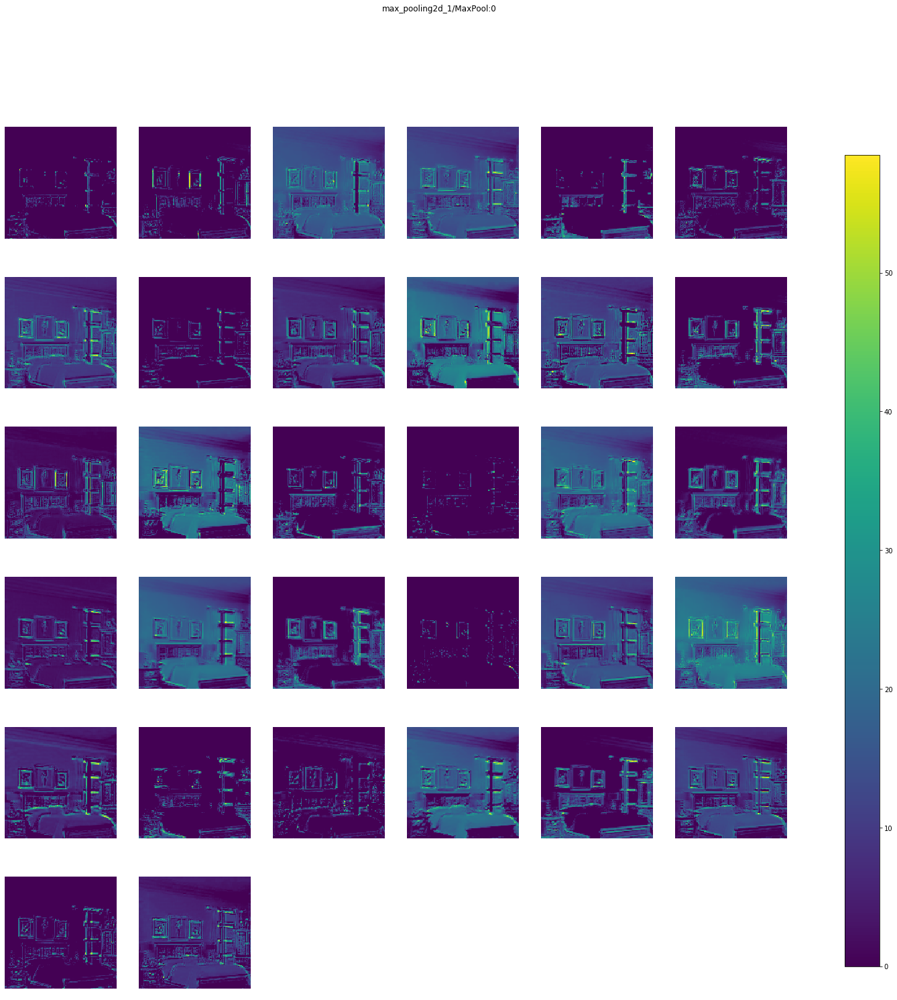

dropout_1/cond/Merge:0 (1, 124, 124, 32) 


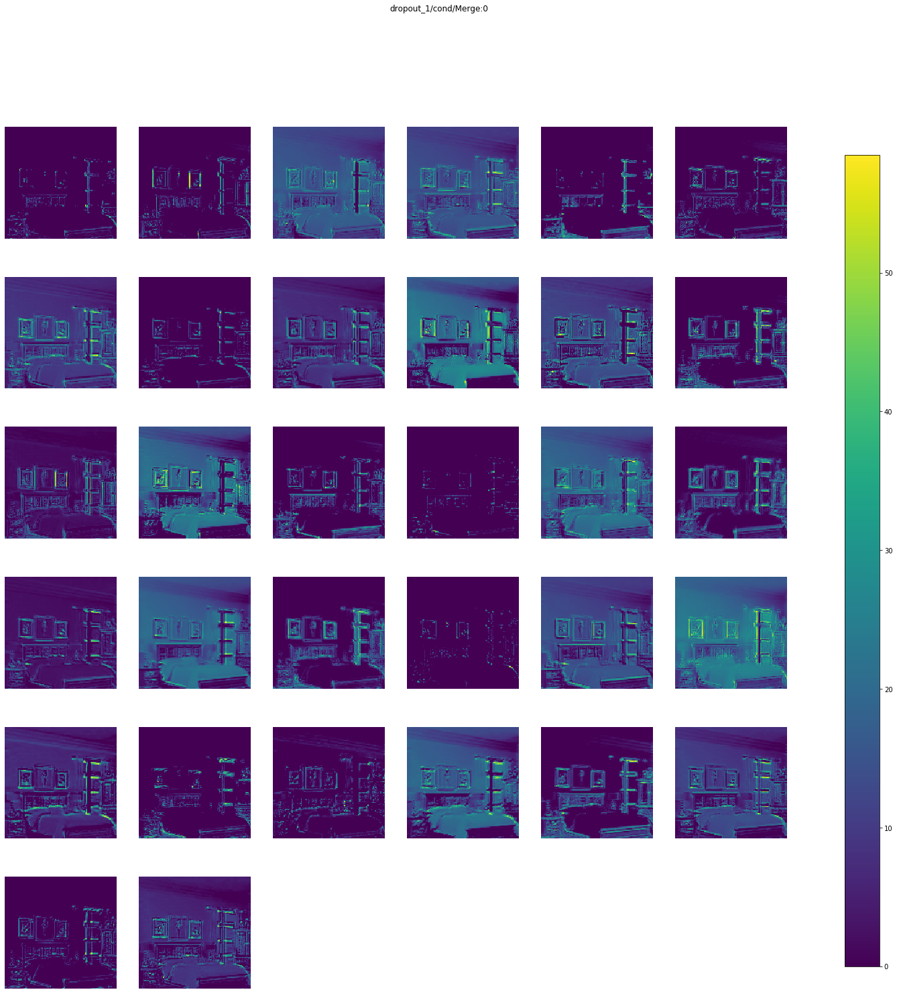

conv2d_3/Relu:0 (1, 120, 120, 64) 


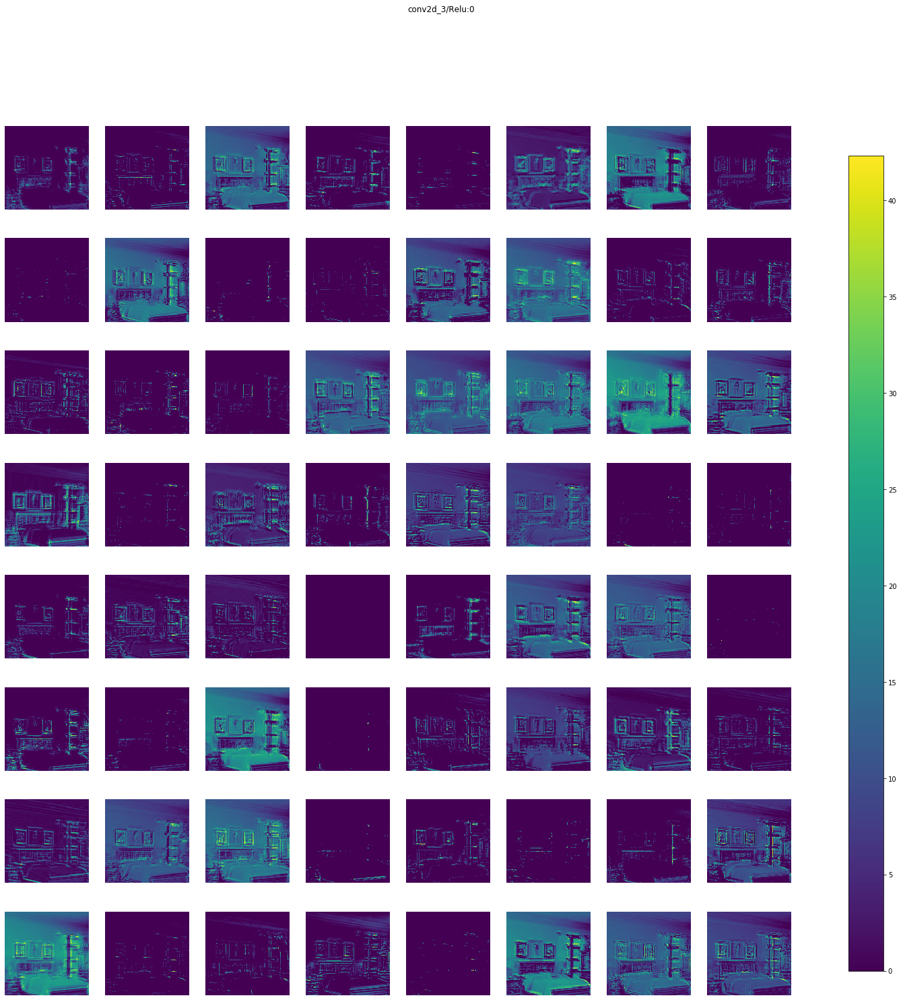

batch_normalization_3/cond/Merge:0 (1, 120, 120, 64) 


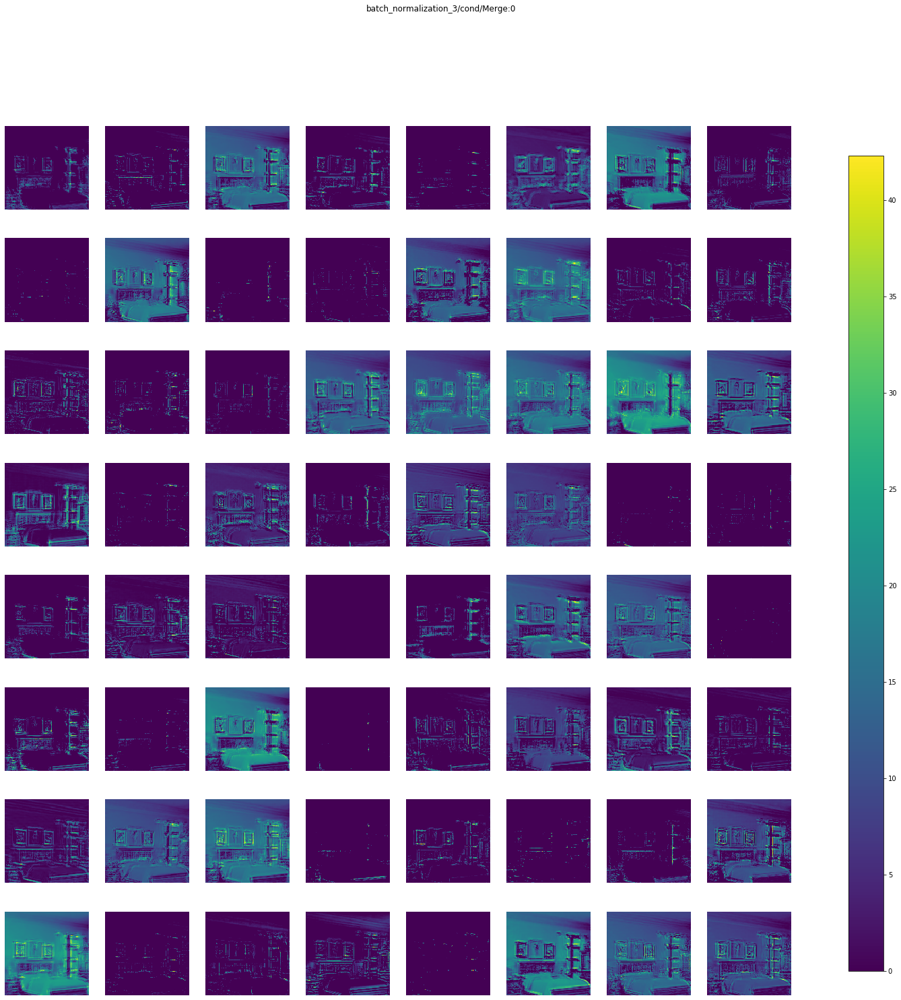

conv2d_4/Relu:0 (1, 116, 116, 64) 


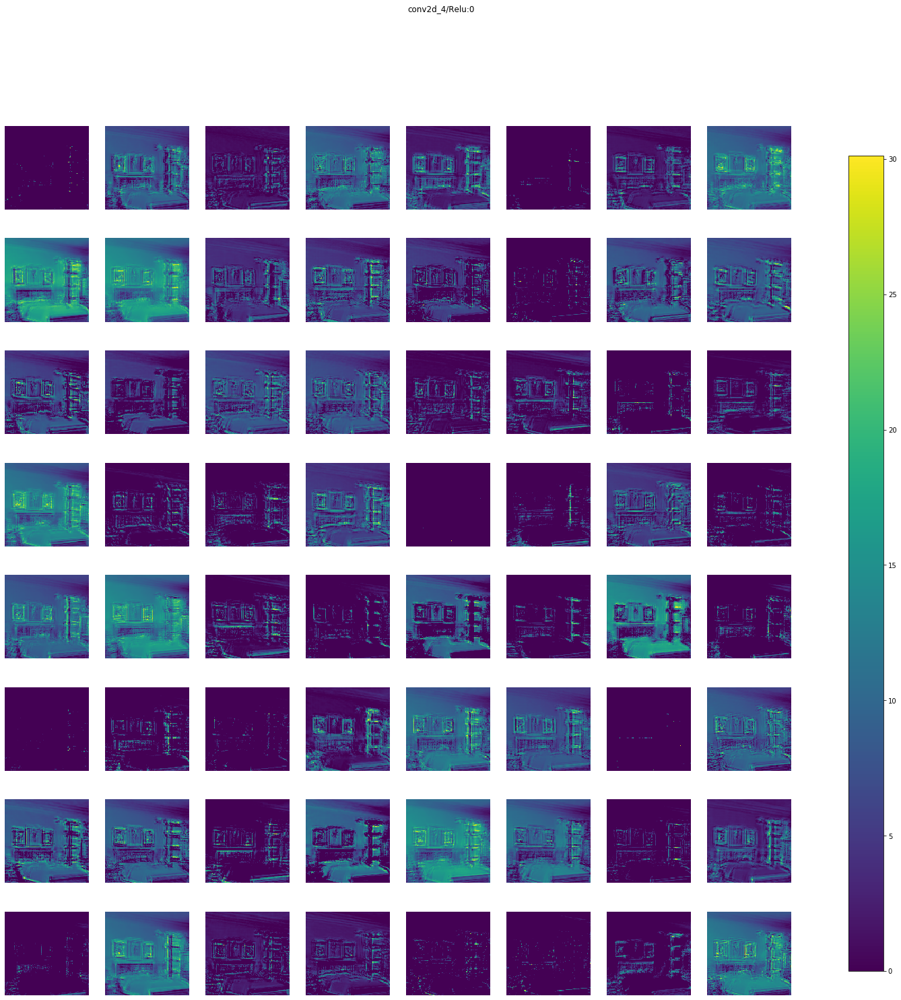

batch_normalization_4/cond/Merge:0 (1, 116, 116, 64) 


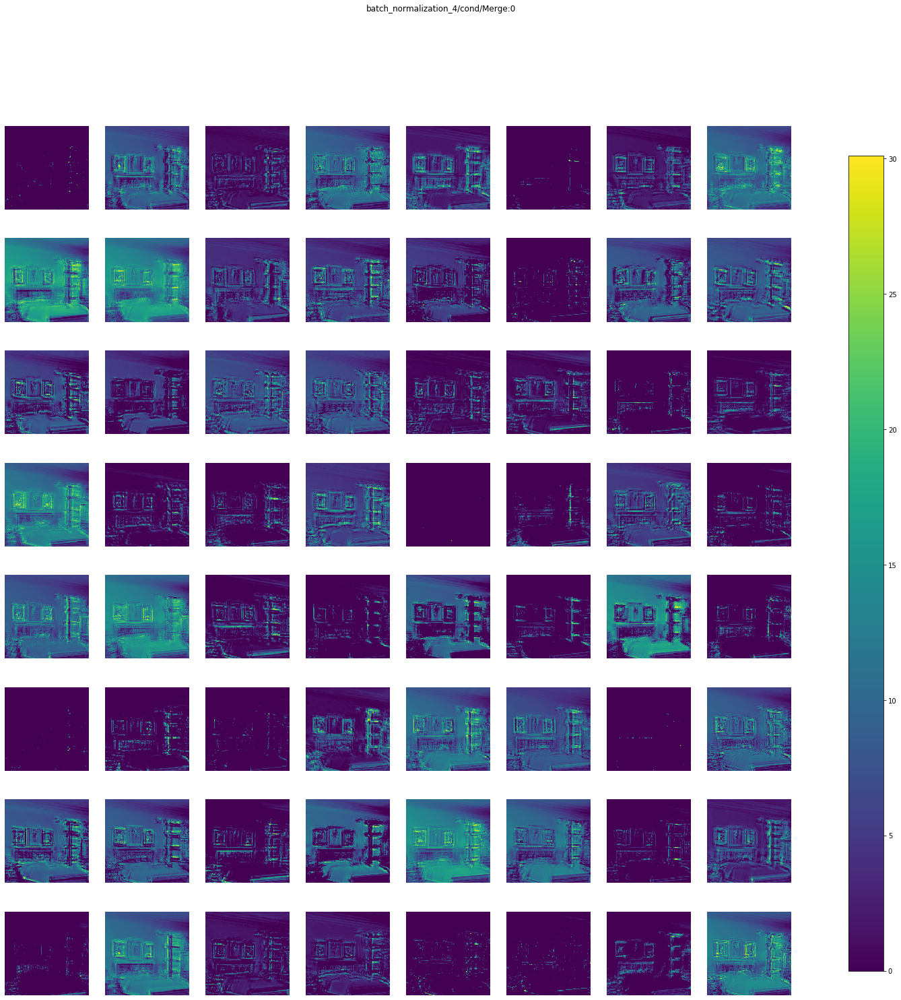

max_pooling2d_2/MaxPool:0 (1, 58, 58, 64) 


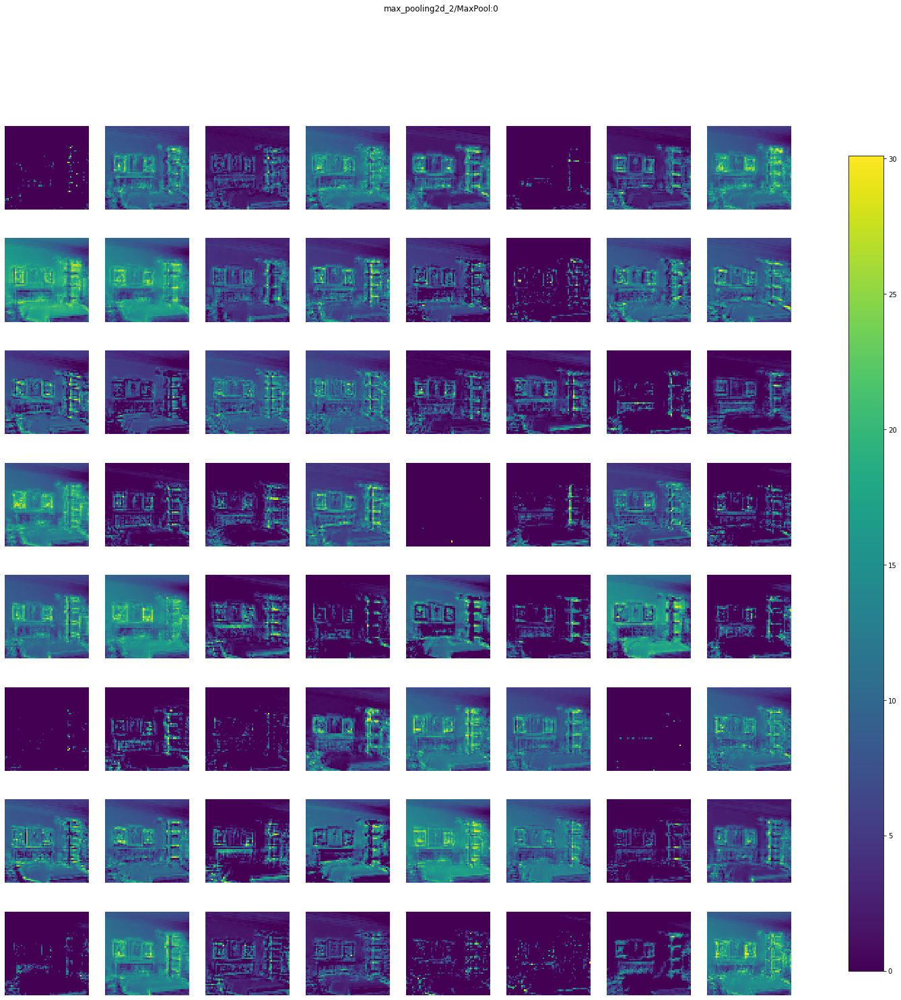

dropout_2/cond/Merge:0 (1, 58, 58, 64) 


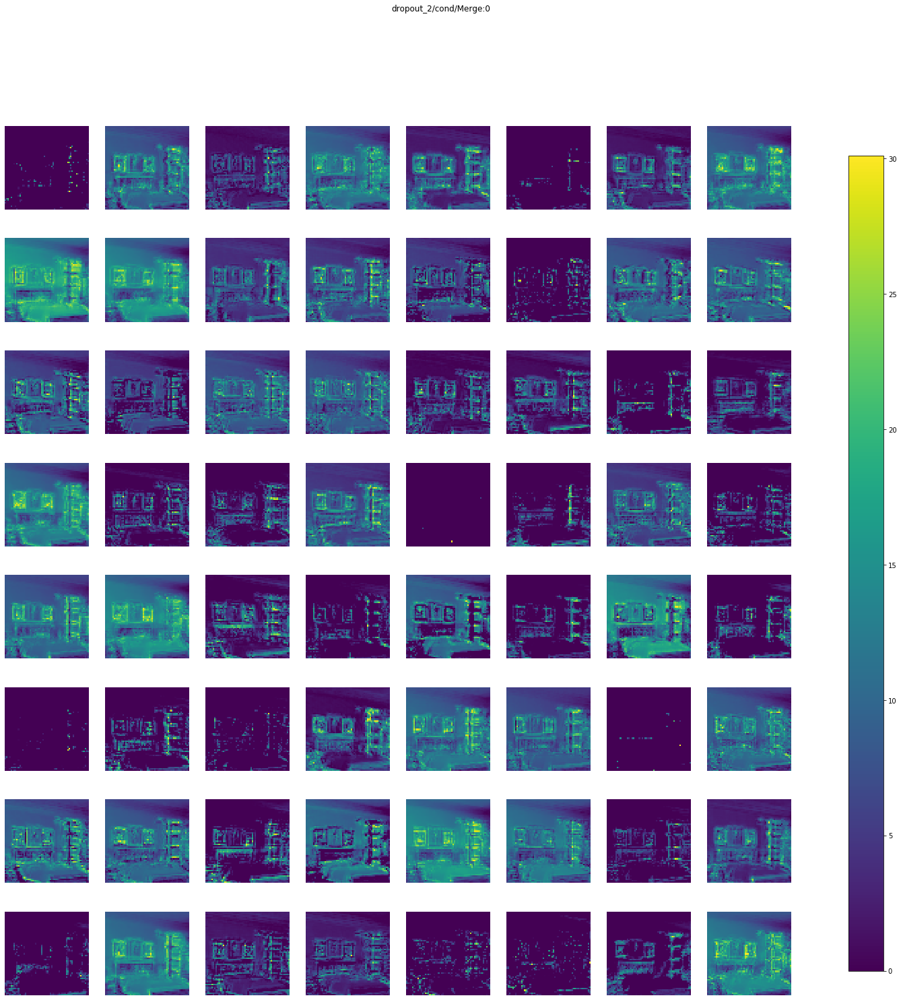

flatten_1/Reshape:0 (1, 215296) 


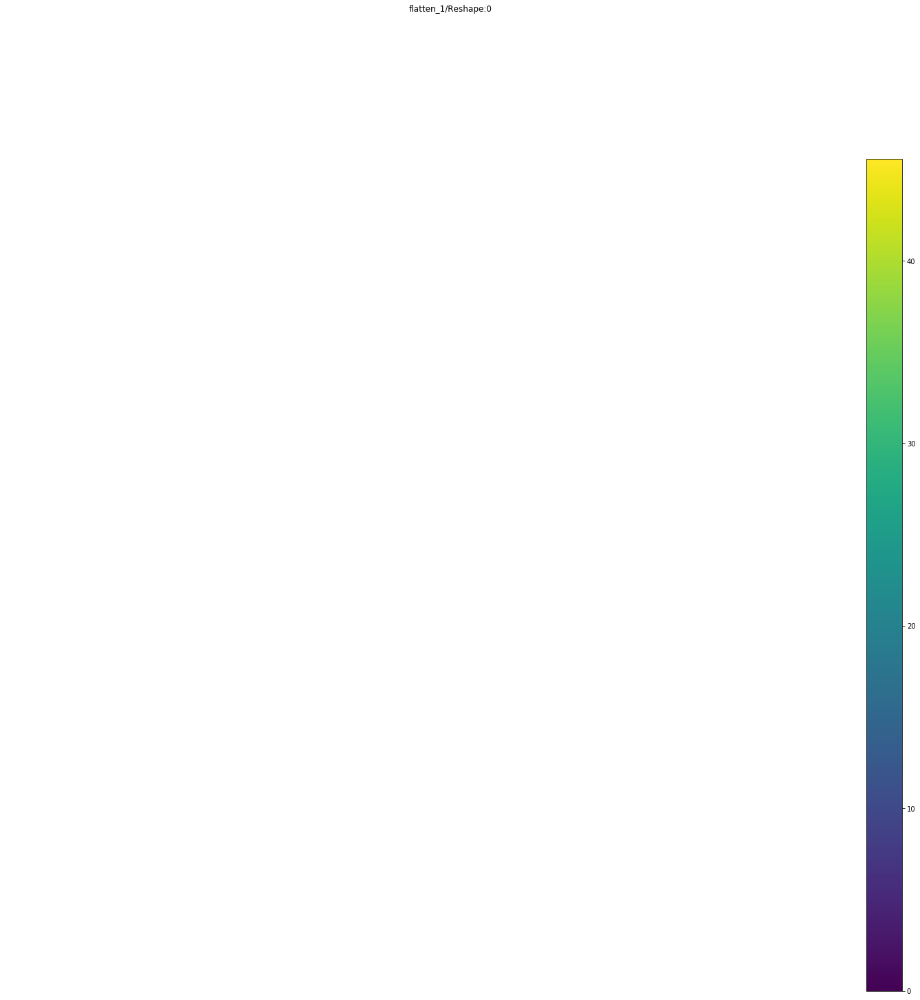

dense_1/Relu:0 (1, 256) 


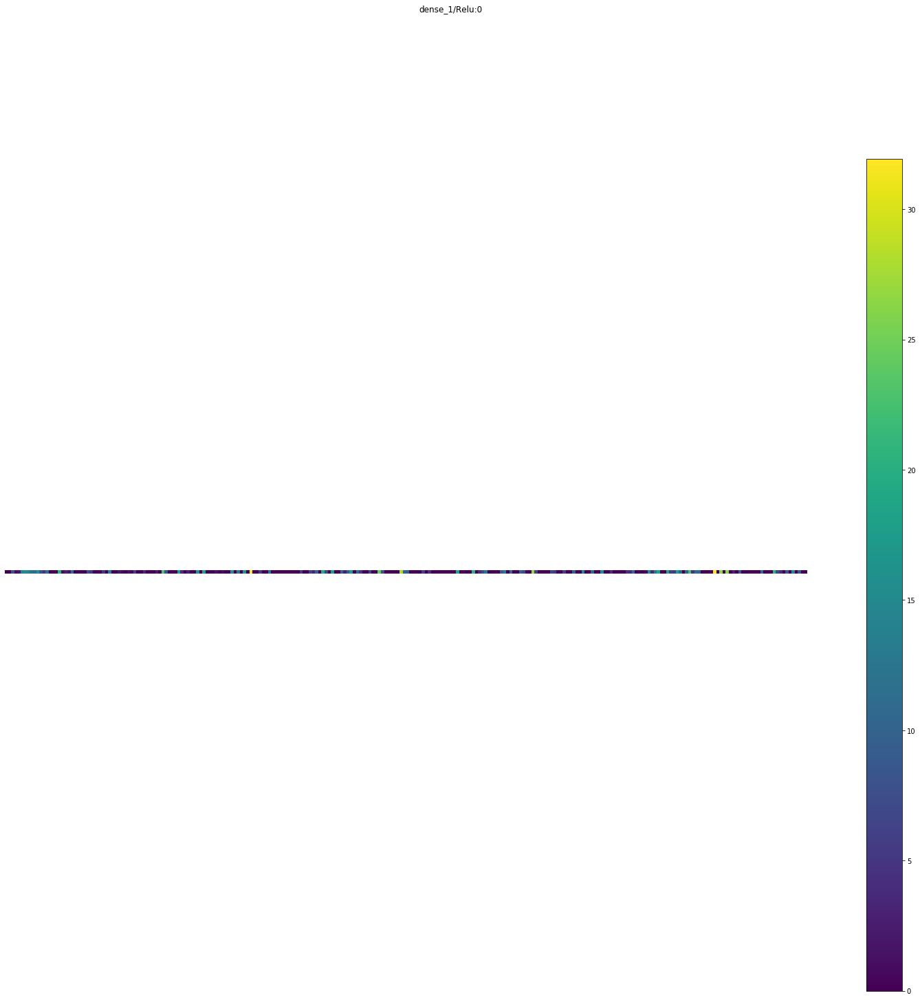

dropout_3/cond/Merge:0 (1, 256) 


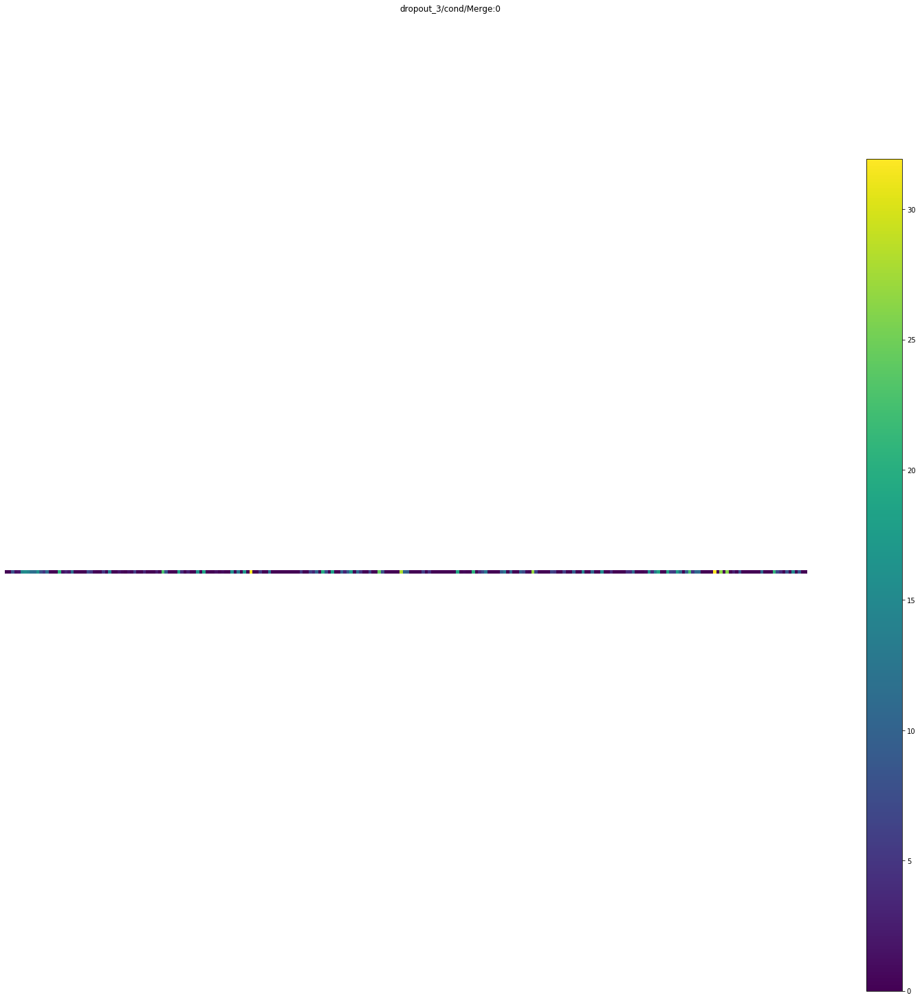

dense_2/Softmax:0 (1, 6) 


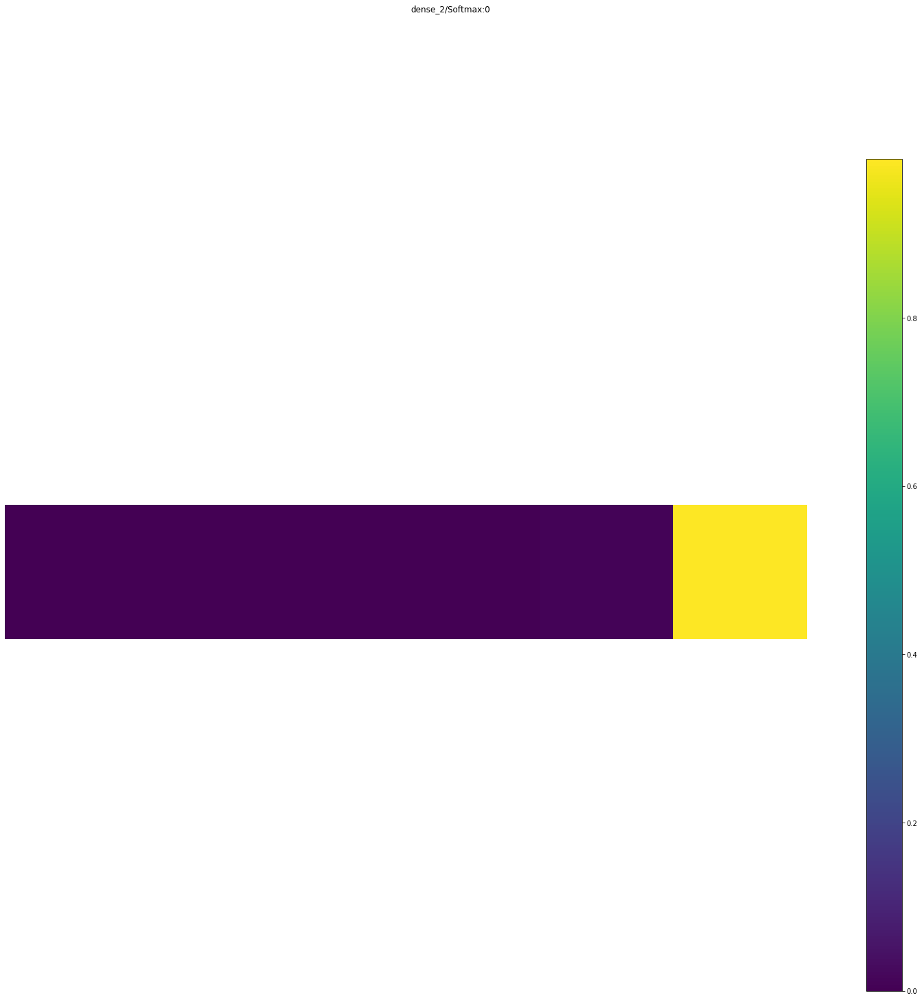

In [26]:
display_activations(activations,)